In [1]:
from tomoSegmentPipeline.utils.common import read_array, write_array
from tomoSegmentPipeline.utils import setup

PARENT_PATH = setup.PARENT_PATH

import numpy as np
import matplotlib.pyplot as plt
import random
import mrcfile
import pandas as pd
import torch
import os
from glob import glob
from pathlib import Path
from skimage.metrics import structural_similarity as ssim


def standardize_and_clip(tomo_data, low=0.005, high=0.995):
    tomo_data = (tomo_data-np.mean(tomo_data))/np.std(tomo_data)
    aux = np.clip(tomo_data, np.quantile(tomo_data, low), np.quantile(tomo_data, high))
    return aux

%matplotlib inline
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

# Brain IXI dataset

In [12]:
img_path = os.path.join(PARENT_PATH, 'ixi_dataset/IXI002-Guys-0828-MRA.nii.gz')

cts_data = standardize_and_clip(read_array(img_path))

tomo_shape = cts_data.shape

tomo_fft = np.fft.fftn(cts_data)
log_power_data = np.log(np.abs(np.fft.fftshift(tomo_fft))**2)

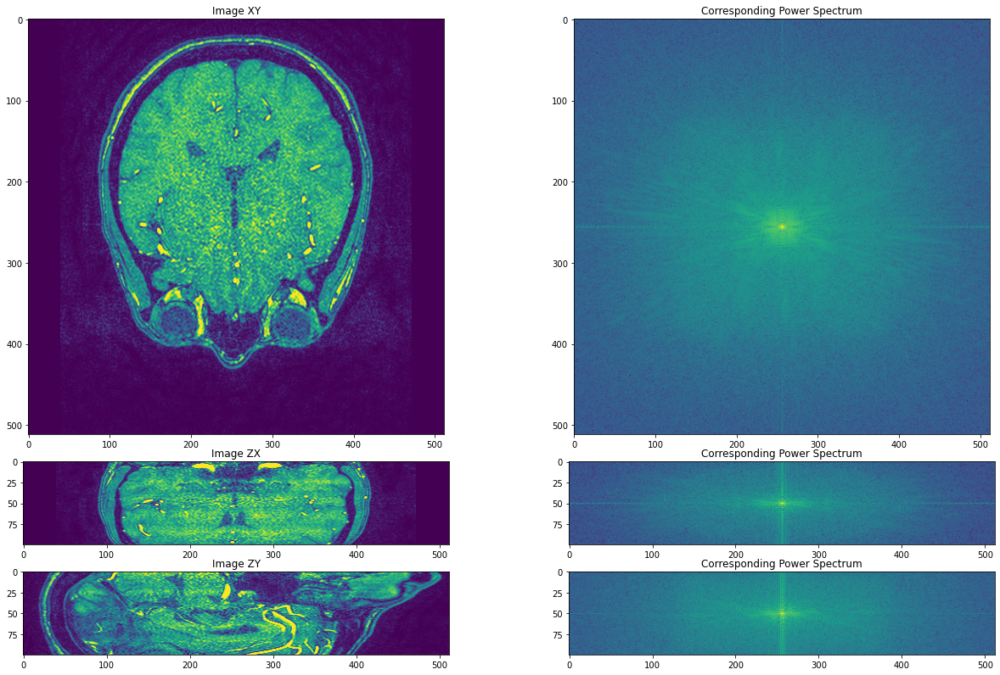

In [27]:
fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [5, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cts_data[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(log_power_data[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cts_data[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(log_power_data[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cts_data[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(log_power_data[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

# Lung Decathlon challenge

In [72]:
img_path = os.path.join(PARENT_PATH, 'decathlon_dataset/Task06_Lung/imagesTr/lung_001.nii.gz')

cts_data = standardize_and_clip(read_array(img_path))

tomo_shape = cts_data.shape

tomo_fft = np.fft.fftn(cts_data)
log_power_data = np.log(np.abs(np.fft.fftshift(tomo_fft))**2)

tomo_shape

(304, 512, 512)

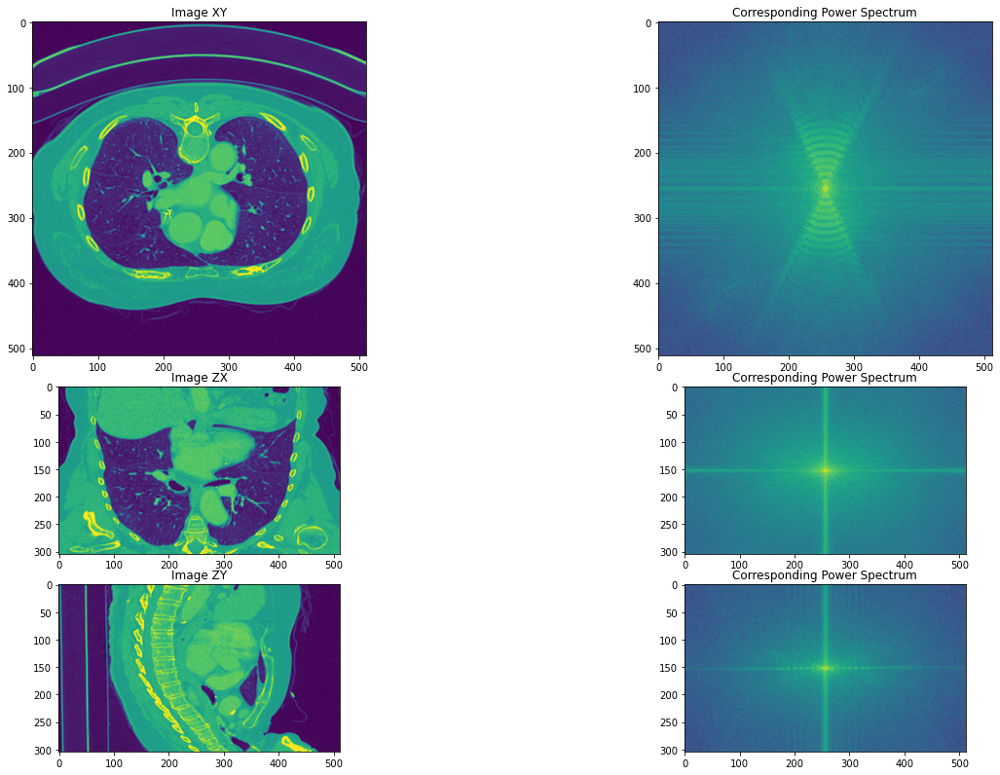

In [46]:
fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cts_data[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(log_power_data[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cts_data[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(log_power_data[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cts_data[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(log_power_data[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

In [61]:
# cts_data2 = np.real(np.fft.ifftn(tomo_fft))

# fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
# plt.tight_layout()

# ax[0][0].imshow(cts_data2[tomo_shape[0]//2])
# ax[0][0].set_title('Image XY')

# ax[0][1].imshow(log_power_data[tomo_shape[0]//2])
# ax[0][1].set_title('Corresponding Power Spectrum')

# ax[1][0].imshow(cts_data2[:, tomo_shape[1]//2, :])
# ax[1][0].set_title('Image ZX')

# ax[1][1].imshow(log_power_data[:, tomo_shape[1]//2, :])
# ax[1][1].set_title('Corresponding Power Spectrum')

# ax[2][0].imshow(cts_data2[:, :, tomo_shape[2]//2])
# ax[2][0].set_title('Image ZY')

# ax[2][1].imshow(log_power_data[:, :, tomo_shape[2]//2])
# ax[2][1].set_title('Corresponding Power Spectrum')


# plt.show()

# EDA Fourier spectrum on cET scans

More thorough EDA in 5.02

According to Strip the Stripes, we can get a mask of corrupted parts of the tomogram using the empirical distribution.

Also plotting along Y, it looks like we can just mask out the missing wedge along the Y axis.

In [79]:
# aux_tomoPath = os.path.join(PARENT_PATH, 'isoNet/RAW_dataset/RAW_allTomos_deconv/tomo02.mrc')
aux_tomoPath = os.path.join(PARENT_PATH, 'isoNet/RAW_dataset/RAW_completeTomoset/tomo10.mrc')
aux_tomoData = standardize_and_clip(read_array(aux_tomoPath))

aux_tomoFft = np.fft.fftn(aux_tomoData)
aux_logPower = np.log(np.abs(np.fft.fftshift(aux_tomoFft))**2)
aux_logPower = standardize_and_clip(aux_logPower, low=0.001, high=0.999)

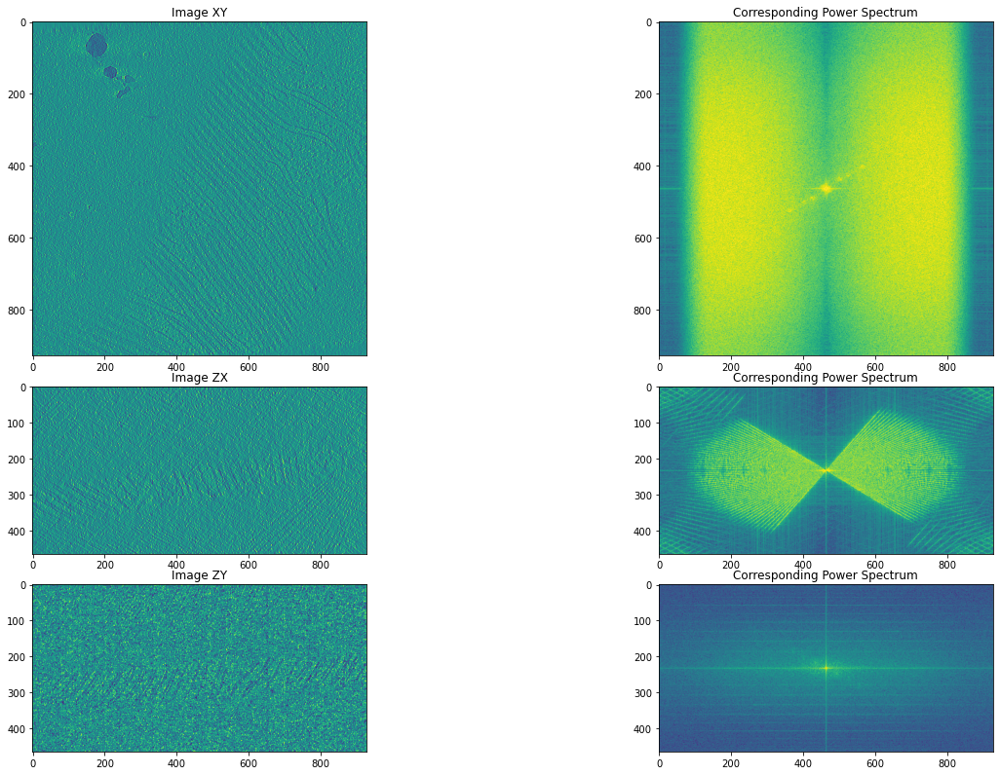

In [80]:
tomo_shape = aux_tomoData.shape

fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(aux_tomoData[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(aux_logPower[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(aux_tomoData[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(aux_logPower[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(aux_tomoData[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(aux_logPower[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

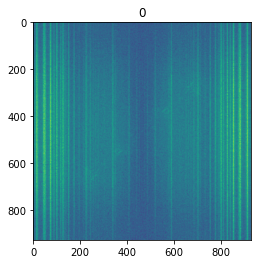

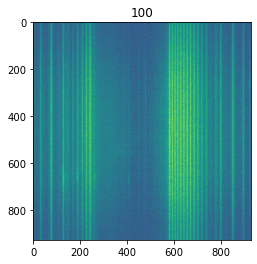

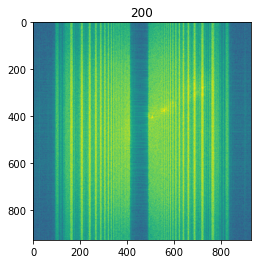

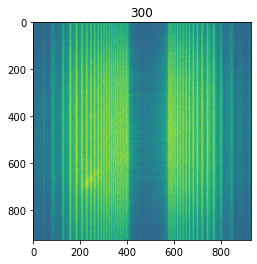

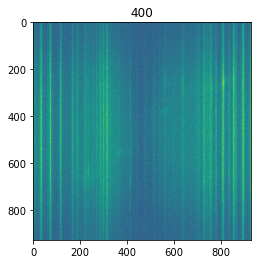

In [81]:
for i in range(0, tomo_shape[0], 100):
    plt.imshow(aux_logPower[i])
    plt.title(i)
    plt.show()

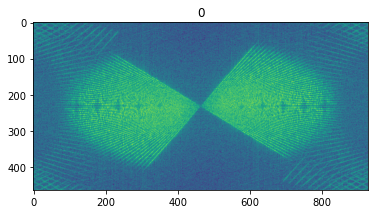

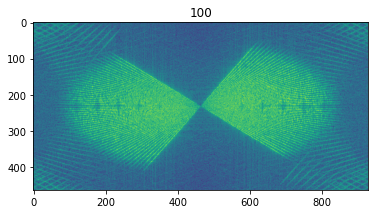

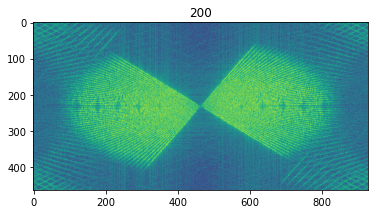

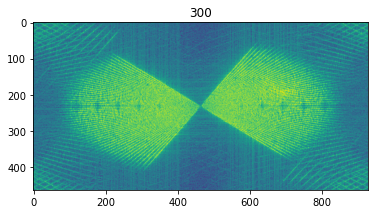

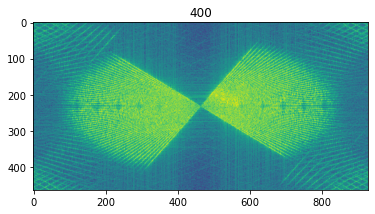

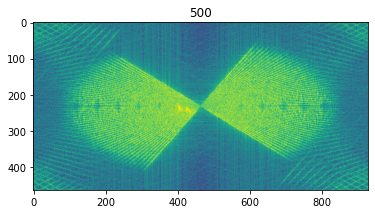

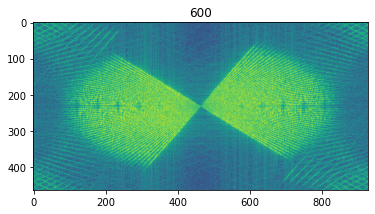

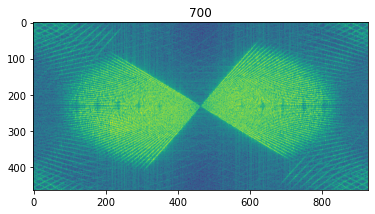

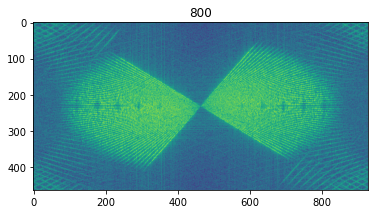

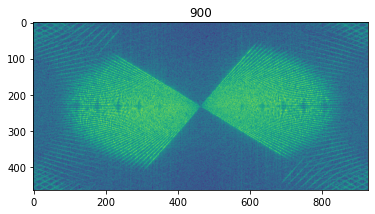

In [82]:
for i in range(0, tomo_shape[1], 100):
    plt.imshow(aux_logPower[:, i, :])
    plt.title(i)
    plt.show()

# Simulating the missing wedge

Idea: take each Y plane and superimpose the missing wedge

## Pilot

In [18]:
img_path = os.path.join(PARENT_PATH, 'data/ixi_dataset/IXI002-Guys-0828-MRA.nii.gz')

cts_data = standardize_and_clip(read_array(img_path))

tomo_shape = cts_data.shape

tomo_fft = np.fft.fftshift(np.fft.fftn(cts_data)) # zero frequency component in the middle
log_power_data = np.log(np.abs(tomo_fft)**2)

In [19]:
tomo_shape

(100, 512, 512)

In [27]:
msk_mesh = np.ones_like(tomo_fft[:, 0, :])

ang_extent = 30

mw_angles0 = np.array([ang_extent, 180-ang_extent])
mw_angles0 = np.deg2rad(mw_angles0)

mw_angles1 = np.array([180+ang_extent, 360-ang_extent])
mw_angles1 = np.deg2rad(mw_angles1)

angles = []

for zidx, z in enumerate(range(-tomo_shape[0]//2, tomo_shape[0]//2)):
    for xidx, x in enumerate(range(-tomo_shape[2]//2, tomo_shape[2]//2)):
        # r = np.linalg.norm([z, x])
        phi = np.arctan2(z, x)
        phi = (2*np.pi+phi)%(2*np.pi)
        
        angles.append(phi)
        
        cond0 = phi > mw_angles0[0] and phi < mw_angles0[1]
        cond1 = phi > mw_angles1[0] and phi < mw_angles1[1]
        
        # whenever a value is inside the missing wedge region, we mask it out
        if cond0 or cond1:
            msk_mesh[zidx, xidx] = 0

In [28]:
mw_tomoFft = tomo_fft.copy()

for y in range(tomo_shape[1]):
    mw_tomoFft[:, y, :] *= np.real(msk_mesh)

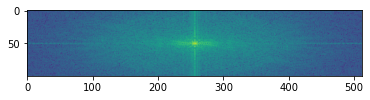

In [29]:
plt.imshow(np.log(np.abs(tomo_fft)**2)[:, tomo_shape[1]//2, :])

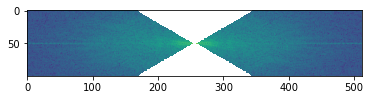

In [30]:
plt.imshow(np.log(np.abs(mw_tomoFft)**2)[:, tomo_shape[1]//2, :])

In [31]:
cts_data2 = np.real(np.fft.ifftn(np.fft.ifftshift(mw_tomoFft)))

tomo_fft2 = np.fft.fftshift(np.fft.fftn(cts_data2))
log_power_data2 = np.log(np.abs(tomo_fft2)**2)

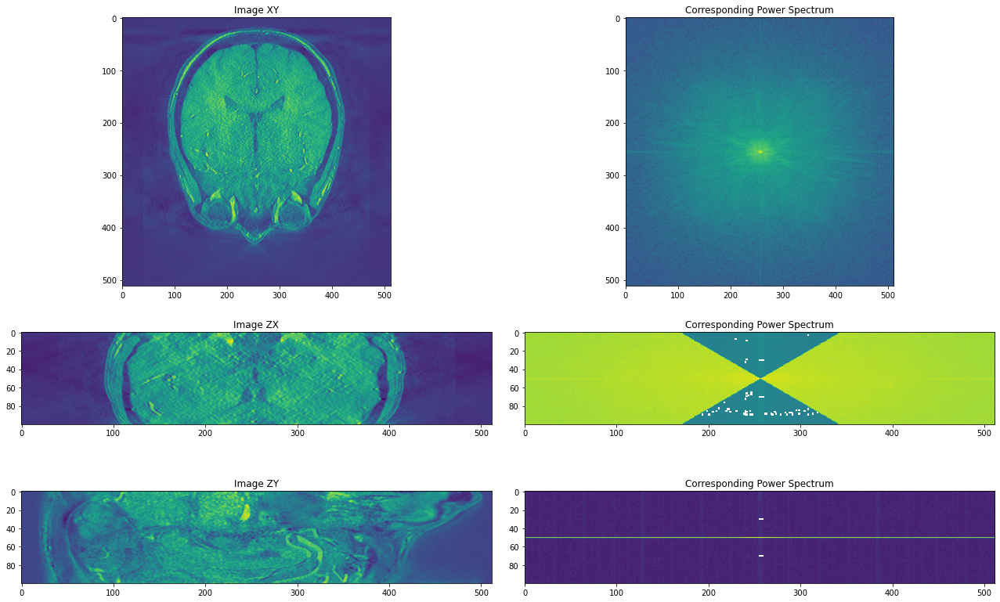

In [32]:
fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cts_data2[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(log_power_data2[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cts_data2[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(log_power_data2[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cts_data2[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(log_power_data2[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

Text(0.5, 1.0, 'Image XY')

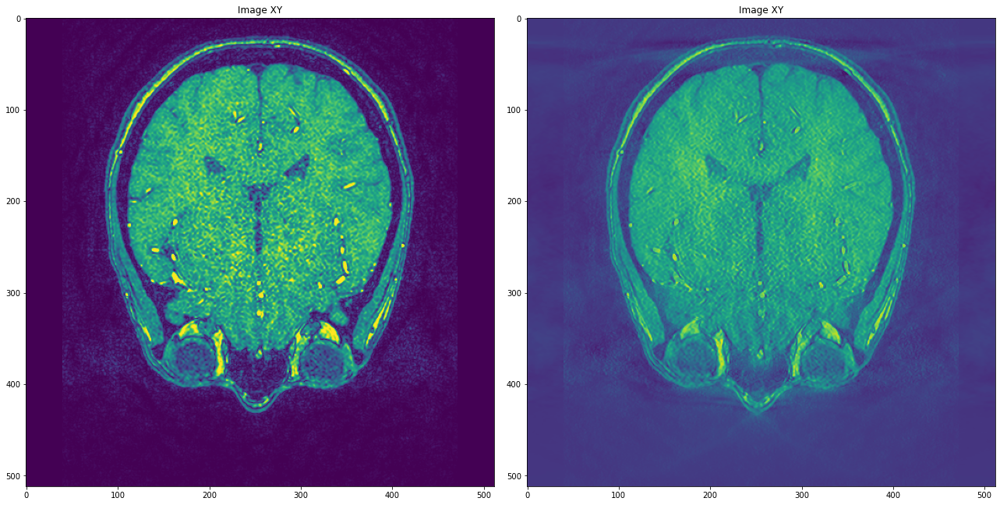

In [33]:
fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
plt.tight_layout()

ax[0].imshow(cts_data[tomo_shape[0]//2])
ax[0].set_title('Image XY')

ax[1].imshow(cts_data2[tomo_shape[0]//2])
ax[1].set_title('Image XY')

Text(0.5, 1.0, 'Missing wedge version ZX')

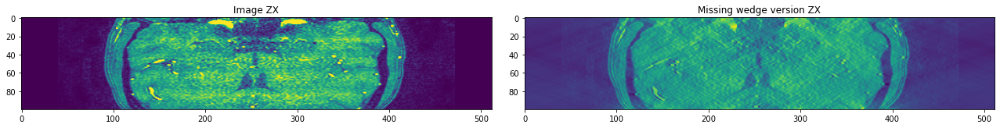

In [34]:
fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
plt.tight_layout()

ax[0].imshow(cts_data[:, tomo_shape[1]//2, :])
ax[0].set_title('Image ZX')

ax[1].imshow(cts_data2[:, tomo_shape[1]//2, :])
ax[1].set_title('Missing wedge version ZX')

In [35]:
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import normalized_mutual_information as nmi

In [36]:
ssim(cts_data, cts_data2)

0.742071483561097

In [37]:
nmi(cts_data, cts_data2)

1.1544454162318258

## Functions

In [39]:
def make_mw_maskY(tomogram_fft, angular_extent):
    """
    Returns a mask with the same shape as that of tomogram_fft. The mask values are zero in the missing wedge along the Y axis.
    
    - angular_extent: the angle in degrees between the horizontal axis and the line where the missing wedge starts.
    """

    assert (angular_extent>0 and angular_extent<90)
    
    tomo_shape = tomogram_fft.shape
    
    # at first the mask does nothing
    msk_mesh = np.ones_like(tomogram_fft[:, 0, :])

    # values within this angles belong to the missing wedge
    mw_angles0 = np.array([angular_extent, 180-angular_extent])
    mw_angles0 = np.deg2rad(mw_angles0)

    mw_angles1 = np.array([180+angular_extent, 360-angular_extent])
    mw_angles1 = np.deg2rad(mw_angles1)

    for zidx, z in enumerate(range(-tomo_shape[0]//2, tomo_shape[0]//2)):
        for xidx, x in enumerate(range(-tomo_shape[2]//2, tomo_shape[2]//2)):
            # r = np.linalg.norm([z, x])
            phi = np.arctan2(z, x)
            phi = (2*np.pi+phi)%(2*np.pi)
            
            cond0 = phi > mw_angles0[0] and phi < mw_angles0[1]
            cond1 = phi > mw_angles1[0] and phi < mw_angles1[1]

            # whenever a value is inside the missing wedge region, we mask it out
            if cond0 or cond1:
                msk_mesh[zidx, xidx] = 0
                
    return msk_mesh

In [43]:
def apply_missing_wedge(tomo_fft, angular_extent):
    """
    First get the mask, then apply it to tomo_fft (which is assumed to be shifted) and return the missing wedge data and fft.
    """
    
    mw_mask = make_mw_maskY(tomo_fft, angular_extent)
    
    mw_tomoFft = tomo_fft.copy()
    
    tomo_shape = tomo_fft.shape

    for y in range(tomo_shape[1]):
        mw_tomoFft[:, y, :] *= np.real(mw_mask)

    mw_tomoData = np.real(np.fft.ifftn(np.fft.ifftshift(mw_tomoFft)))
    
    return mw_tomoData, mw_tomoFft

In [44]:
def plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft):
    
    """
    - Plot XY, ZX, YZ planes (left out coordinate at center) of the given tomograms with their corresponding FT spectrums.
    - Plot normal vs corrupted for XY and ZX
    """
    tomo_shape = tomo_data.shape
    
    # log_power_data = np.log(np.abs(np.fft.fftshift(tomo_fft))**2)
    mw_log_power_data = np.log(np.abs(mw_tomoFft)**2)

    fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
    plt.tight_layout()

    ax[0][0].imshow(mw_tomoData[tomo_shape[0]//2])
    ax[0][0].set_title('Image XY')

    ax[0][1].imshow(mw_log_power_data[tomo_shape[0]//2])
    ax[0][1].set_title('Corresponding Power Spectrum')

    ax[1][0].imshow(mw_tomoData[:, tomo_shape[1]//2, :])
    ax[1][0].set_title('Image ZX')

    ax[1][1].imshow(mw_log_power_data[:, tomo_shape[1]//2, :])
    ax[1][1].set_title('Corresponding Power Spectrum')

    ax[2][0].imshow(mw_tomoData[:, :, tomo_shape[2]//2])
    ax[2][0].set_title('Image ZY')

    ax[2][1].imshow(mw_log_power_data[:, :, tomo_shape[2]//2])
    ax[2][1].set_title('Corresponding Power Spectrum')

    plt.show()
    
    print('----------------------------------------------------------------------------------------------------------------------------------------------------------------')
    
    fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
    plt.tight_layout()

    ax[0].imshow(tomo_data[tomo_shape[0]//2])
    ax[0].set_title('Image XY')

    ax[1].imshow(mw_tomoData[tomo_shape[0]//2])
    ax[1].set_title('Image XY')
    
    plt.show()
    
    print('----------------------------------------------------------------------------------------------------------------------------------------------------------------')
    fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
    plt.tight_layout()

    ax[0].imshow(tomo_data[:, tomo_shape[1]//2, :])
    ax[0].set_title('Image ZX')

    ax[1].imshow(mw_tomoData[:, tomo_shape[1]//2, :])
    ax[1].set_title('Missing wedge version ZX')
    
    return

# Get missing wedge dummy tomograms

## Decathlon: Lung task

Original tomogram shape:  (304, 512, 512)
New tomogram shape:  (300, 512, 512)


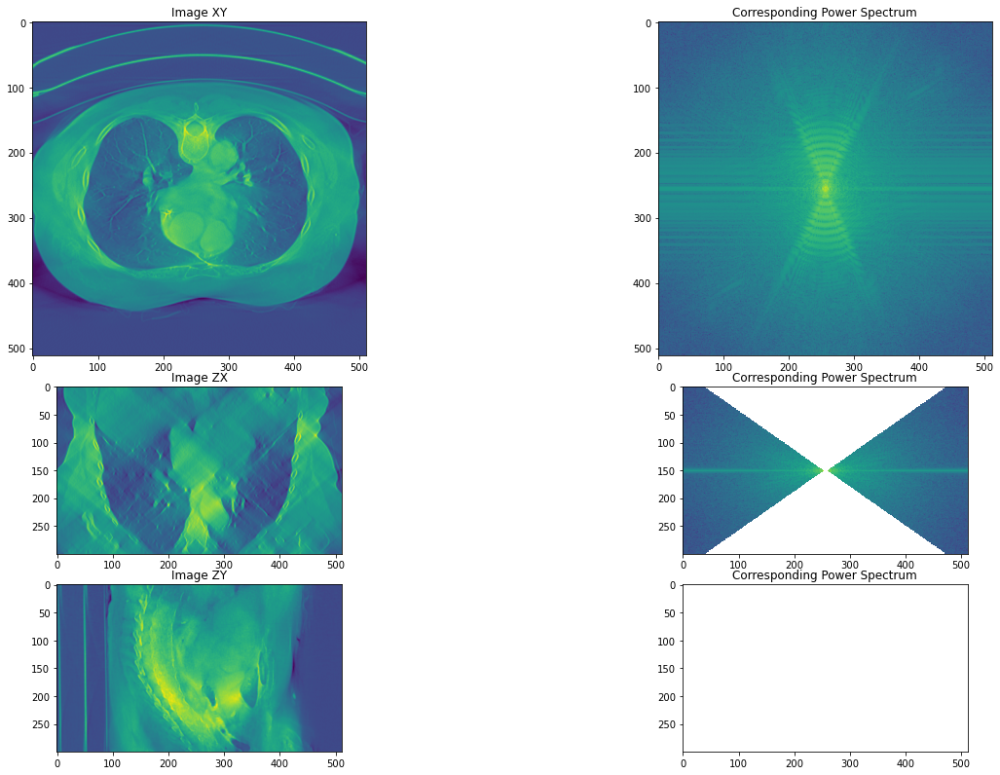

----------------------------------------------------------------------------------------------------------------------------------------------------------------


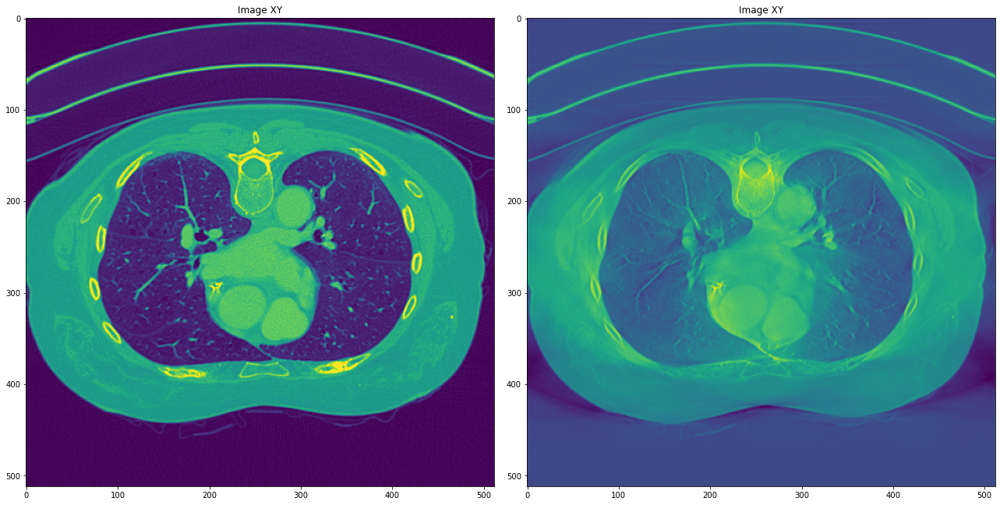

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Original tomogram shape:  (301, 512, 512)
New tomogram shape:  (300, 512, 512)


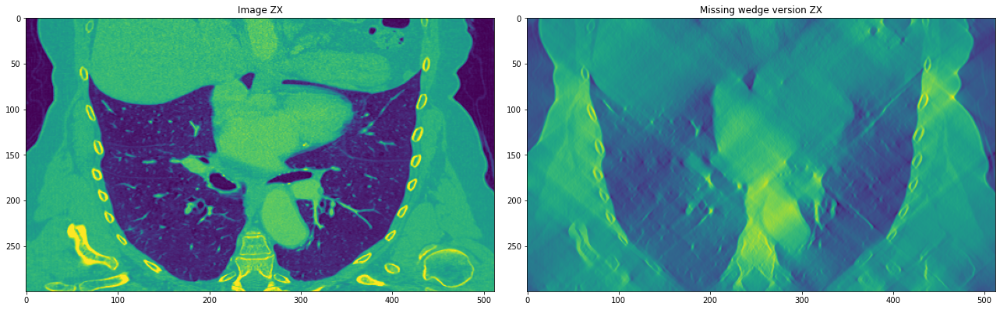

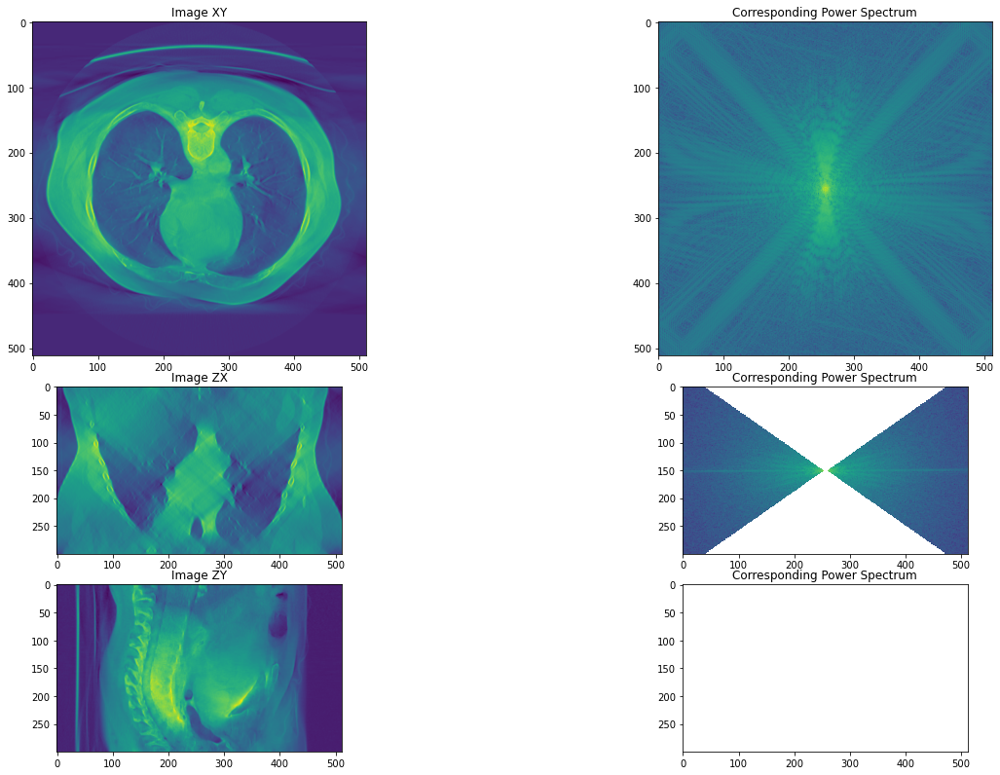

----------------------------------------------------------------------------------------------------------------------------------------------------------------


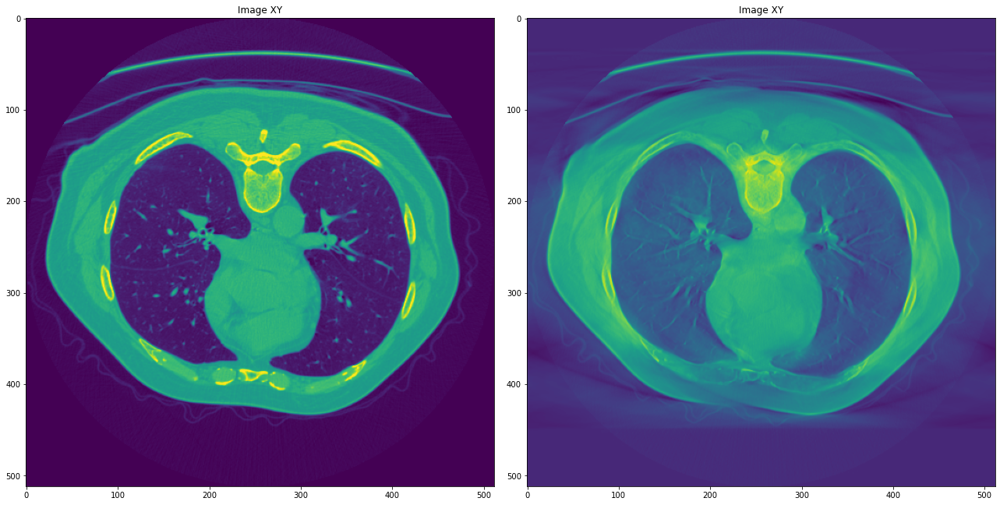

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Original tomogram shape:  (314, 512, 512)
New tomogram shape:  (300, 512, 512)


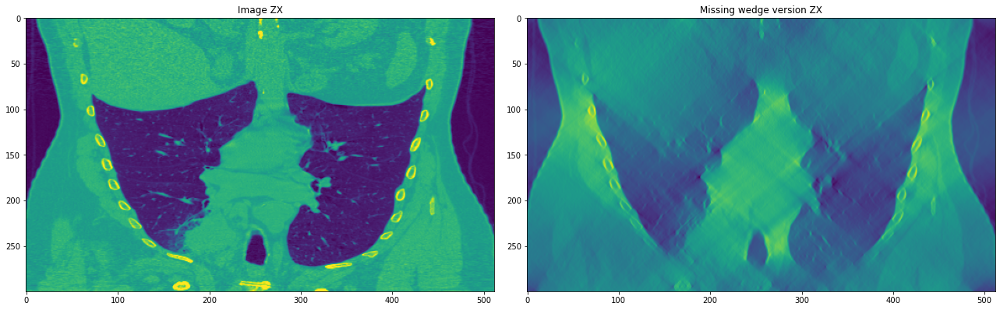

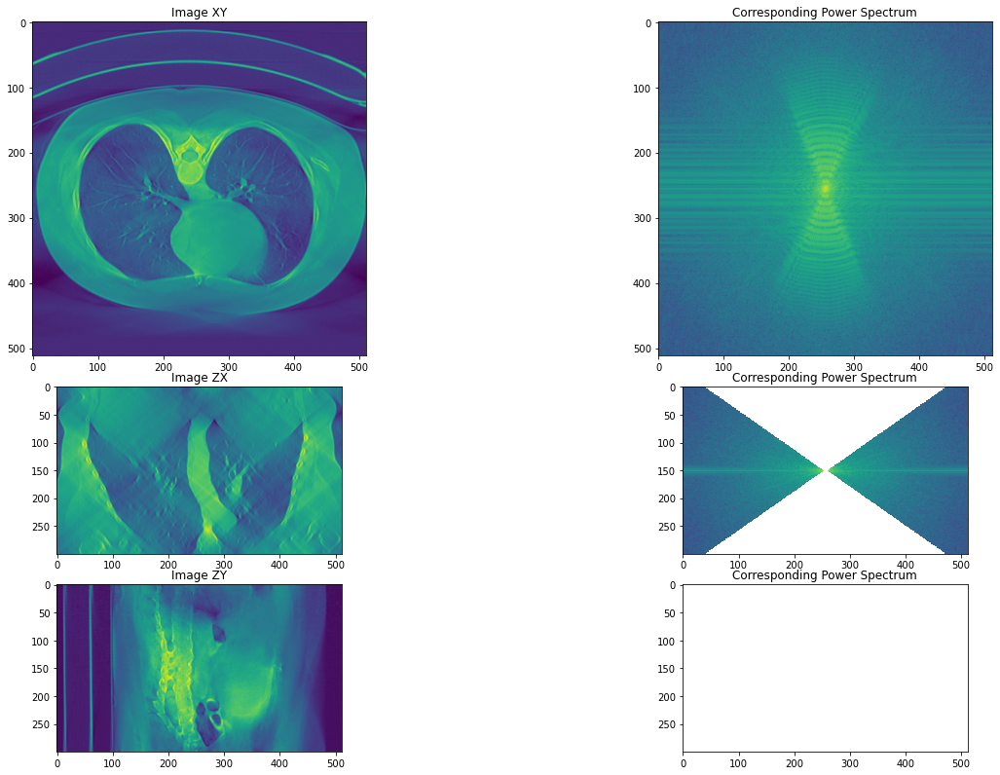

----------------------------------------------------------------------------------------------------------------------------------------------------------------


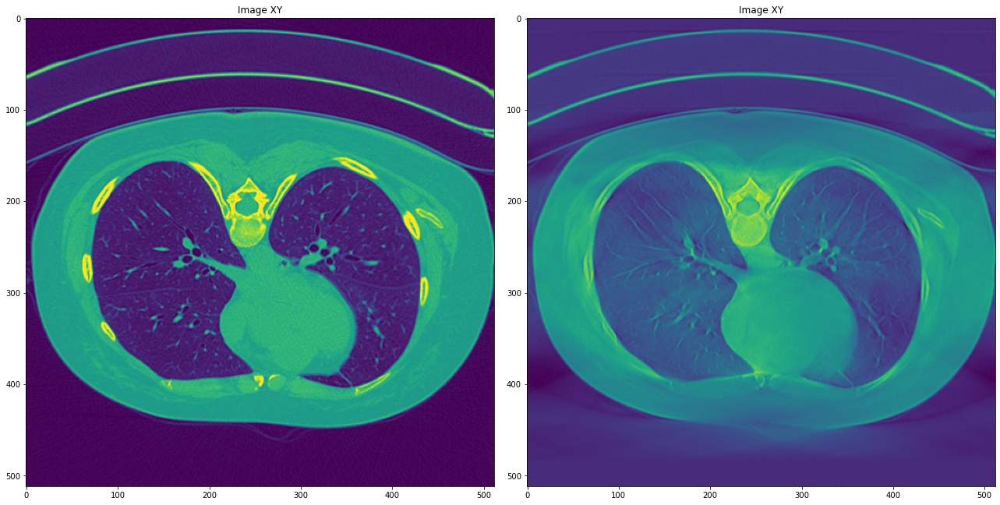

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Original tomogram shape:  (304, 512, 512)
New tomogram shape:  (300, 512, 512)


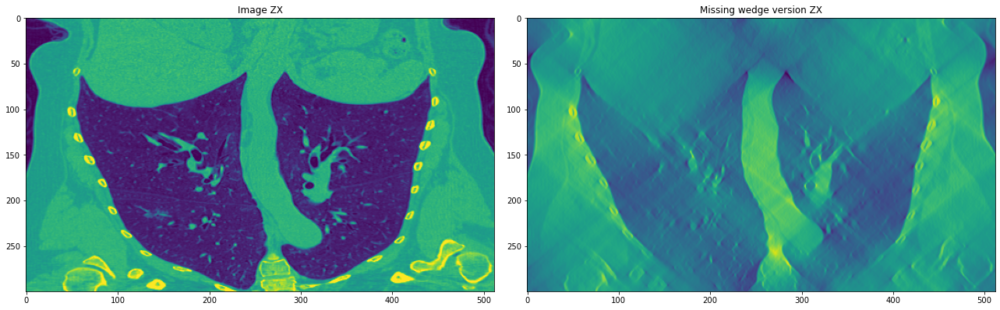

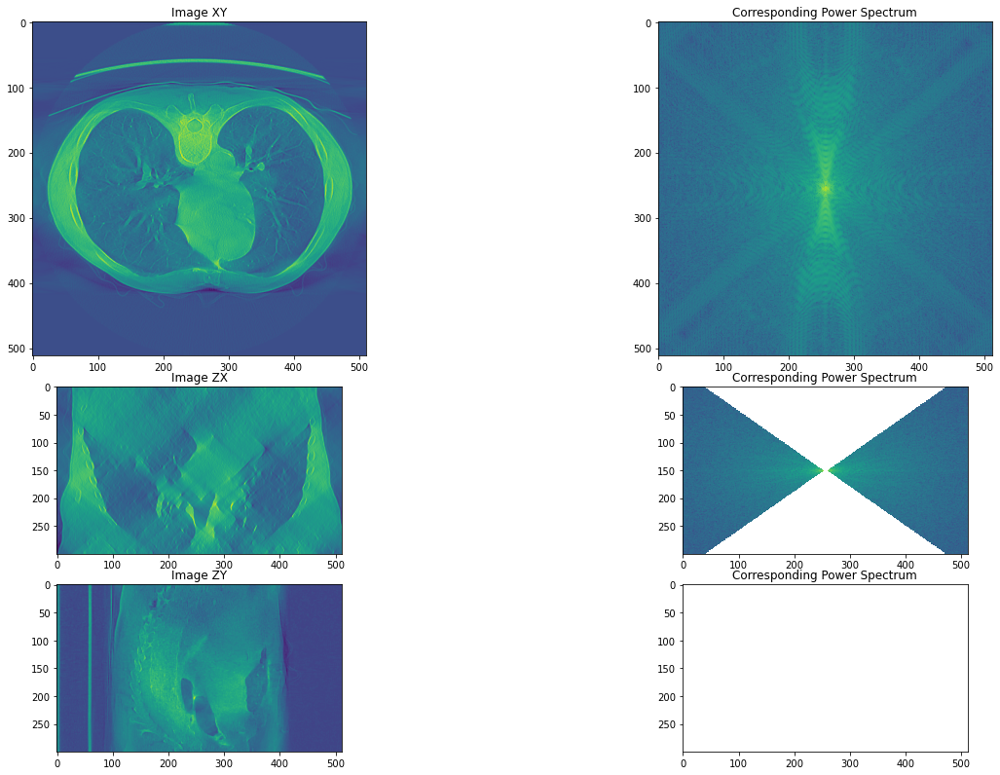

----------------------------------------------------------------------------------------------------------------------------------------------------------------


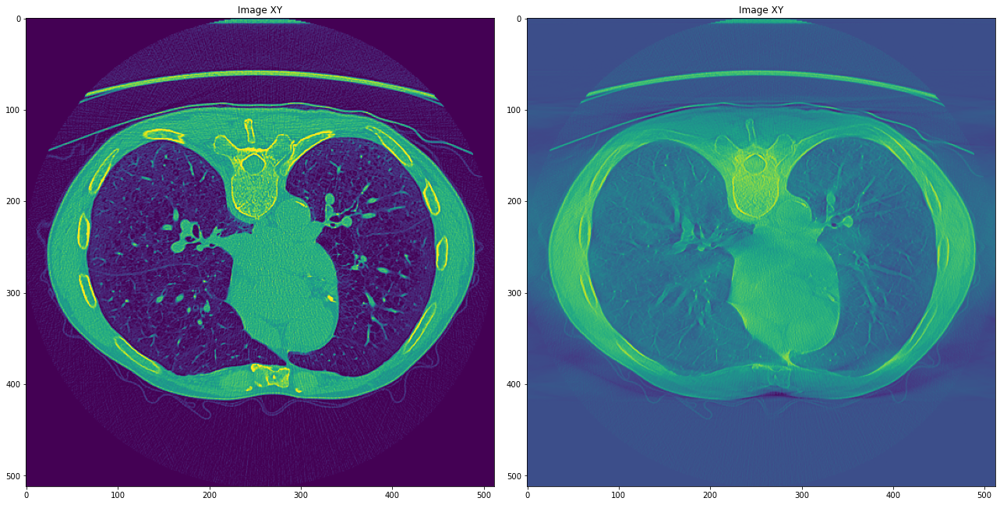

----------------------------------------------------------------------------------------------------------------------------------------------------------------


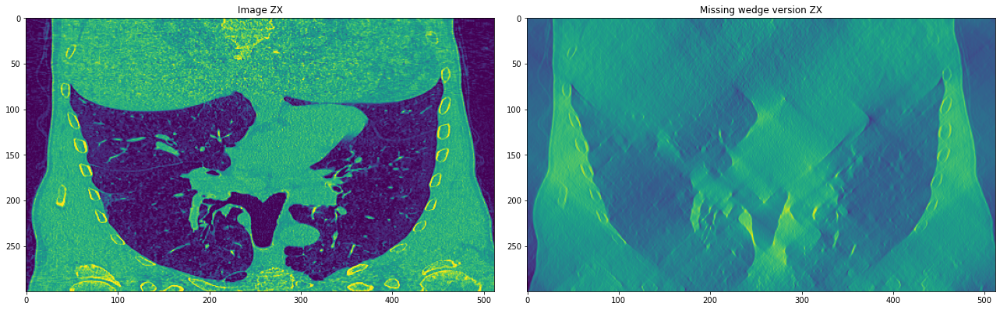

In [53]:
img_base_path = os.path.join(PARENT_PATH, 'data/decathlon_dataset/Task06_Lung/imagesTr/')
# img_paths = glob(img_base_path+'*') # used when I didn't know which images had z between 300 and 315
img_paths = [os.path.join(img_base_path, 'lung_%03d.nii.gz'%x) for x in [1, 9, 20, 31]]

angular_extent = 35

out_path = 'data/isoNet/lung_dummyData_ae%02d/lung_corrupted/' %angular_extent
out_path = os.path.join(PARENT_PATH, out_path)

counter = 0

for img_path in sorted(img_paths):
        
    img_name = img_path.split('/')[-1].split('.')[0]
    mw_img_name = img_name + '_corrupted_ae%02d.mrc' %angular_extent
    
    tomo_data = read_array(img_path)
    tomo_shape = tomo_data.shape
    
    # we want only tomograms with z between 300 and 315
    if tomo_shape[0]>300 and tomo_shape[0]<315:
        
        print('Original tomogram shape: ', tomo_shape)
        
        tomo_data = standardize_and_clip(tomo_data[0:300])
        tomo_shape = tomo_data.shape
        
        print('New tomogram shape: ', tomo_shape)
        
        tomo_fft = np.fft.fftshift(np.fft.fftn(tomo_data))

        mw_tomoData, mw_tomoFft = apply_missing_wedge(tomo_fft, angular_extent=angular_extent)

        Path(out_path).mkdir(parents=True, exist_ok=True)

        write_array(np.float32(mw_tomoData), os.path.join(out_path, mw_img_name))
        
        plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft)
        
        counter+=1
        
        if counter==5:
            break

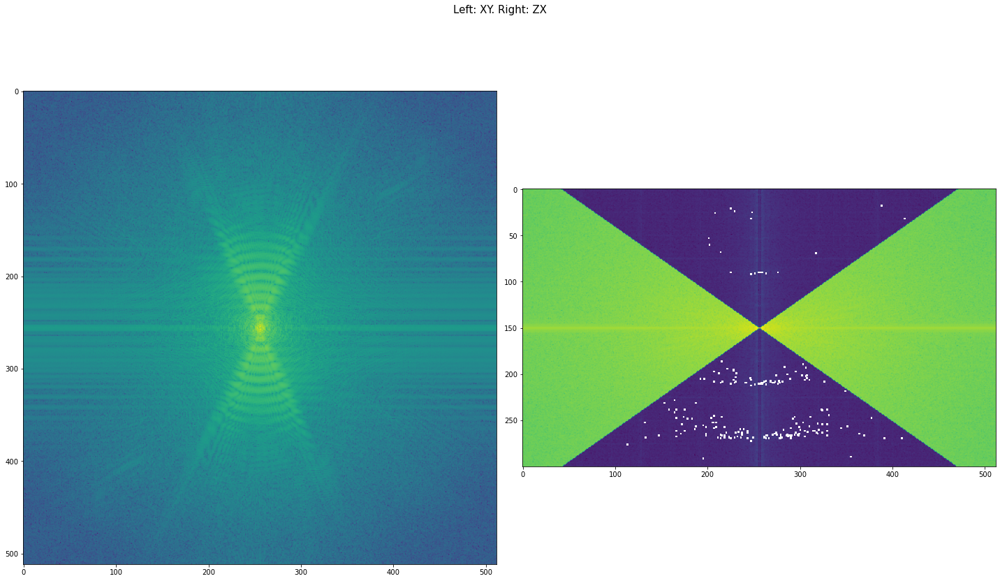

In [52]:
# # sanity Check: running the fft on mw_tomoData recovers the expected mw_power spectrum
# mw_tomoFft2 = np.fft.fftshift(np.fft.fftn(mw_tomoData))
# mw_log_power_data = np.log(np.abs(mw_tomoFft2)**2)

# fig, ax = plt.subplots(1, 2, figsize=(20, 13))
        
# fig.suptitle('Left: XY. Right: ZX', fontsize=15)    

# ax[0].imshow(mw_log_power_data[tomo_shape[0]//2])
# ax[1].imshow(mw_log_power_data[:, tomo_shape[1]//2, :])

# # plt.subplots_adjust(hspace = -0.5)
# plt.tight_layout()
# plt.show()

## IXI: Brain

In [60]:
out_path = 'data/isoNet/brain_dummyData/brain_corrupted/'
out_path = os.path.join(PARENT_PATH, out_path)

file_list = ['IXI002-Guys-0828-MRA.nii.gz', 'IXI013-HH-1212-MRA.nii.gz',
             'IXI019-Guys-0702-MRA.nii.gz',
             'IXI026-Guys-0696-MRA.nii.gz', 'IXI039-HH-1261-MRA.nii.gz']

angular_extent = 15

out_path = 'data/isoNet/brain_dummyData_ae%02d/brain_corrupted/' %angular_extent
out_path = os.path.join(PARENT_PATH, out_path)

for i in file_list:
    
    img_path = os.path.join(PARENT_PATH, 'data/ixi_dataset/%s' %i)
    
    img_name = img_path.split('/')[-1].split('.')[0]
    mw_img_name = img_name + '_corrupted_ae%02d.mrc' %angular_extent
    
    tomo_data = standardize_and_clip(read_array(img_path))

    tomo_fft = np.fft.fftshift(np.fft.fftn(tomo_data))

    tomo_shape = tomo_fft.shape
    
    print('Tomogram shape: ', tomo_shape)

    mw_tomoData, mw_tomoFft = apply_missing_wedge(tomo_fft, angular_extent=angular_extent)
    
    Path(out_path).mkdir(parents=True, exist_ok=True)
    
    write_array(np.float32(mw_tomoData), os.path.join(out_path, mw_img_name))

Tomogram shape:  (100, 512, 512)
Tomogram shape:  (100, 512, 512)
Tomogram shape:  (100, 512, 512)
Tomogram shape:  (100, 512, 512)
Tomogram shape:  (100, 512, 512)


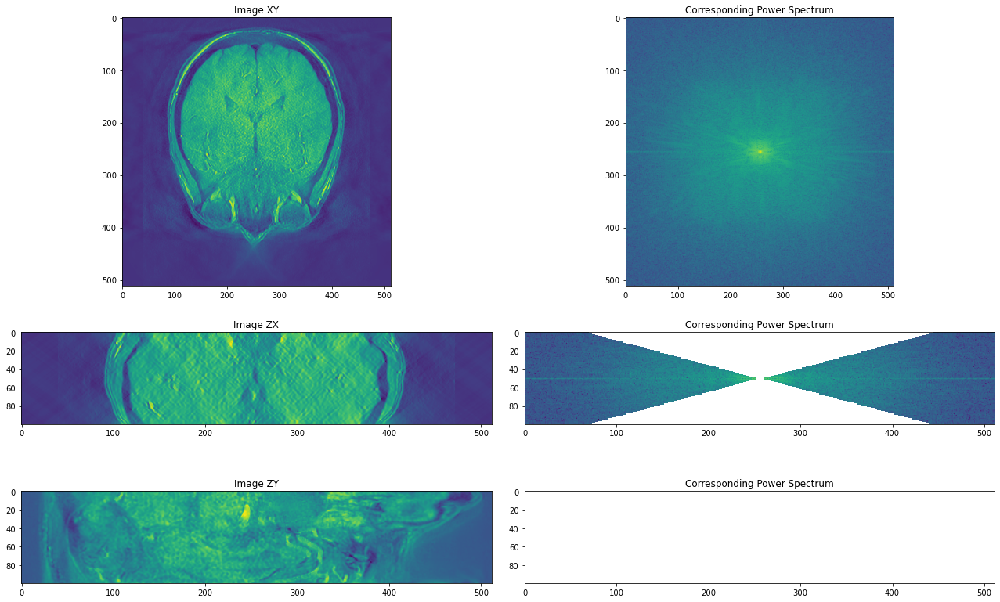

----------------------------------------------------------------------------------------------------------------------------------------------------------------


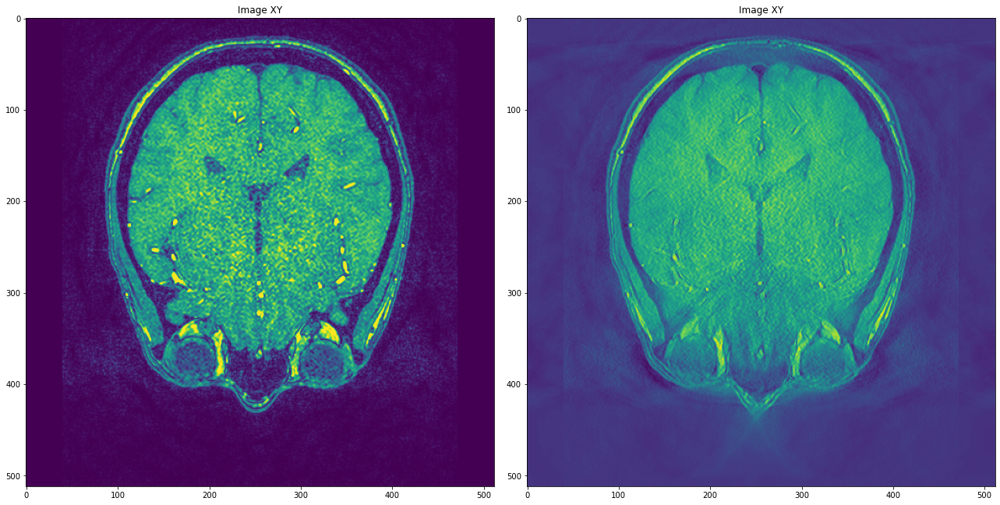

----------------------------------------------------------------------------------------------------------------------------------------------------------------


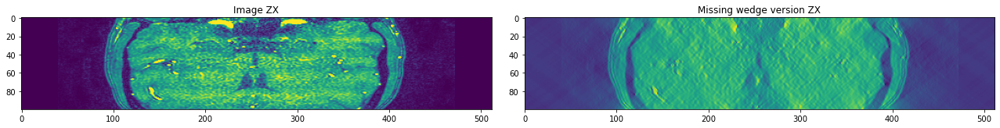

In [56]:
plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft)

## IXI: Brain Rotated

In [58]:
import torch

Tomogram rotated 90 degrees 0 times along XY


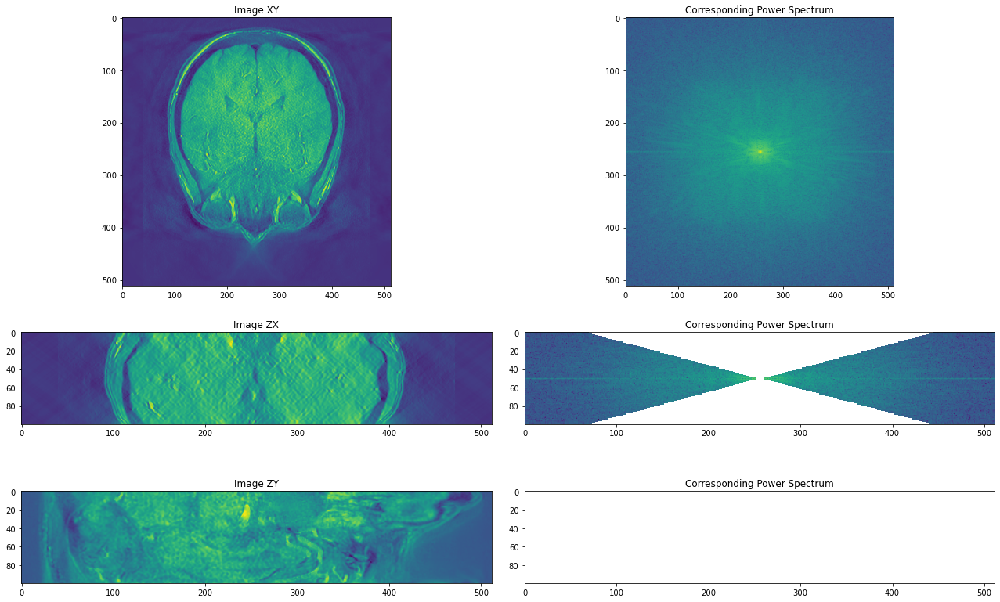

----------------------------------------------------------------------------------------------------------------------------------------------------------------


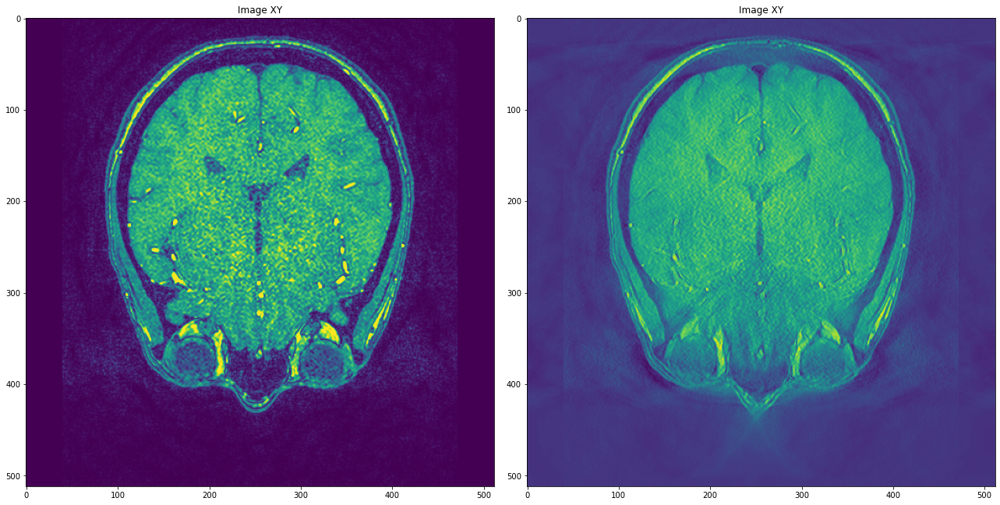

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Tomogram rotated 90 degrees 1 times along XY


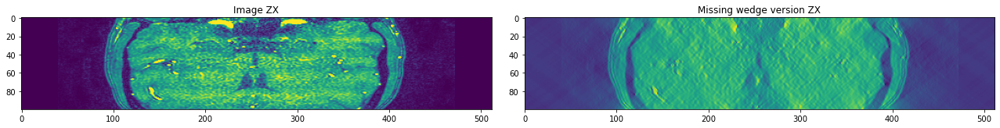

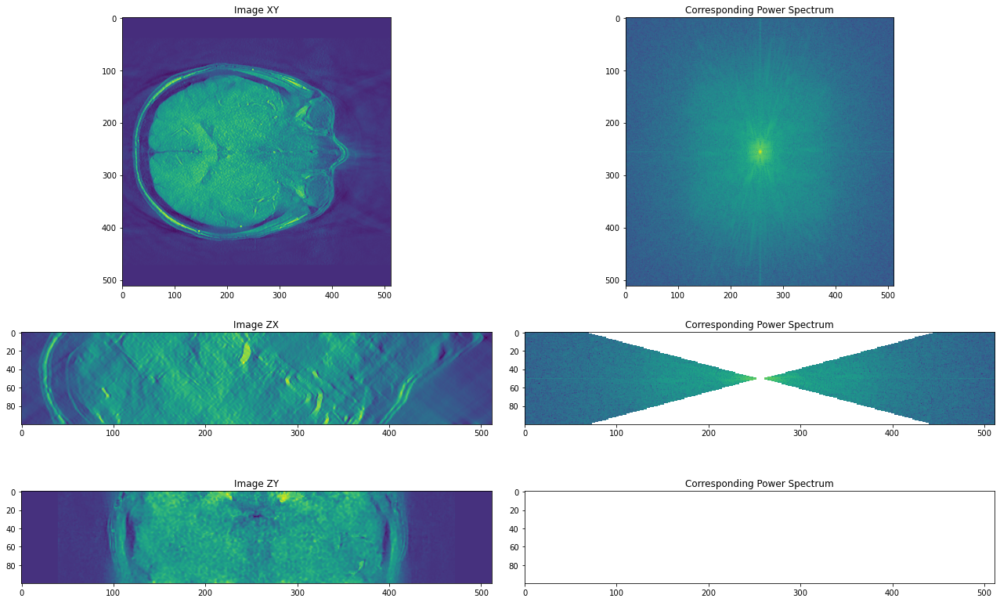

----------------------------------------------------------------------------------------------------------------------------------------------------------------


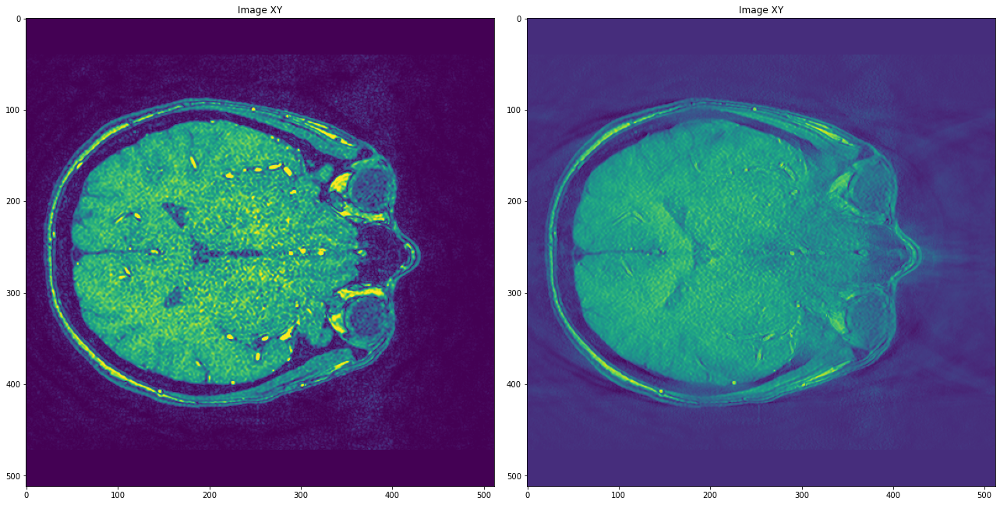

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Tomogram rotated 90 degrees 2 times along XY


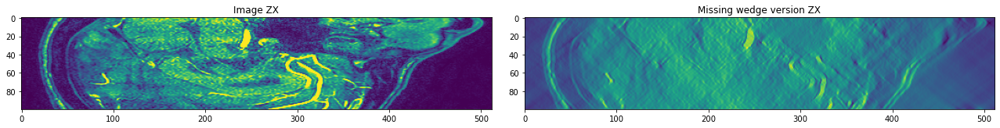

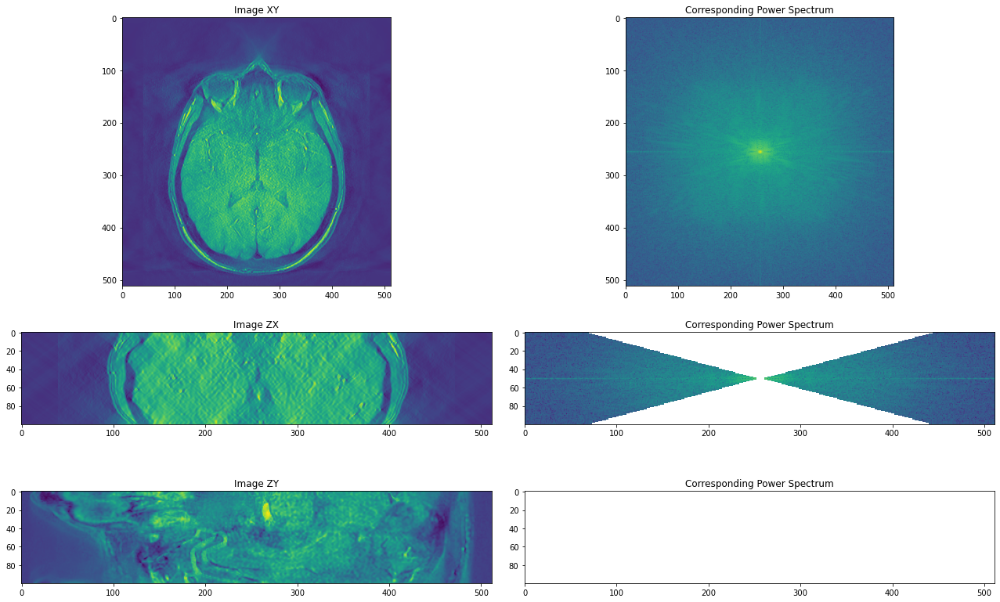

----------------------------------------------------------------------------------------------------------------------------------------------------------------


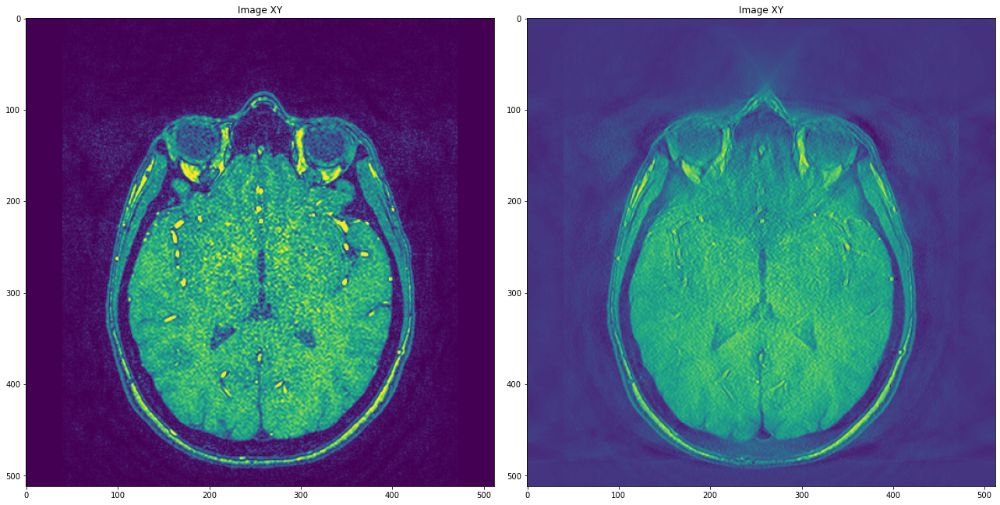

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Tomogram rotated 90 degrees 3 times along XY


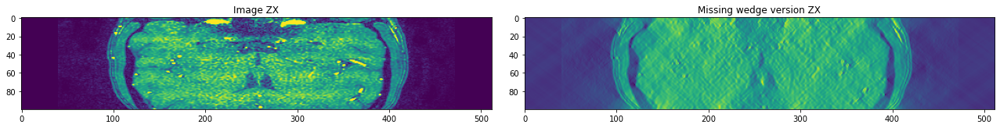

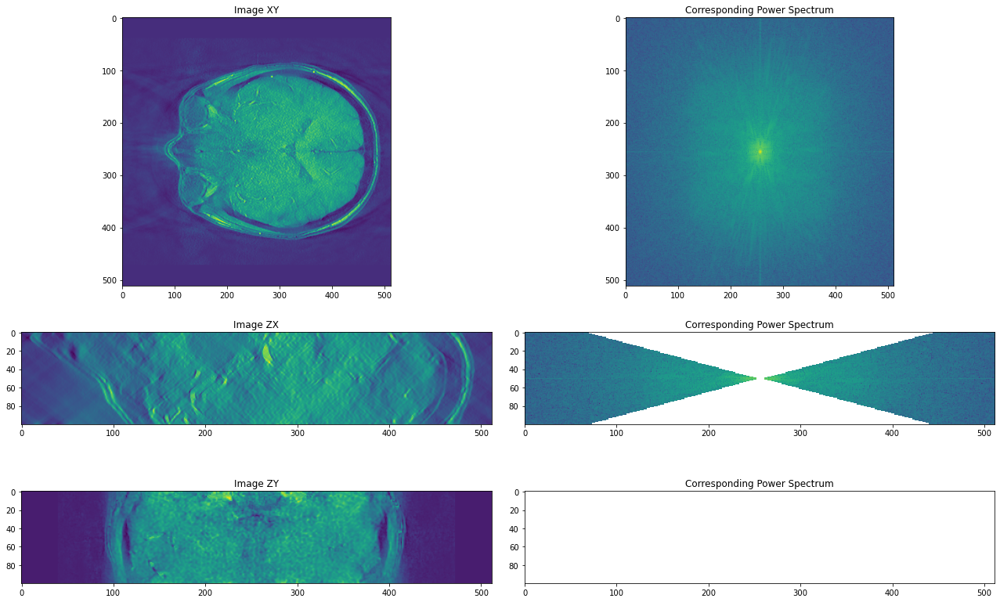

----------------------------------------------------------------------------------------------------------------------------------------------------------------


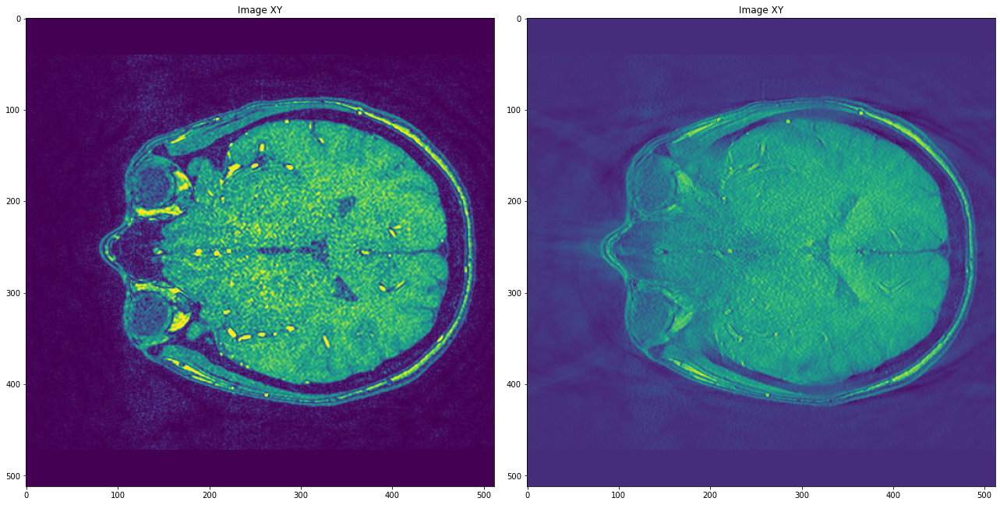

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Tomogram rotated 180 XZ


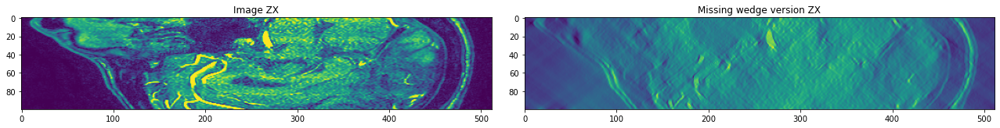

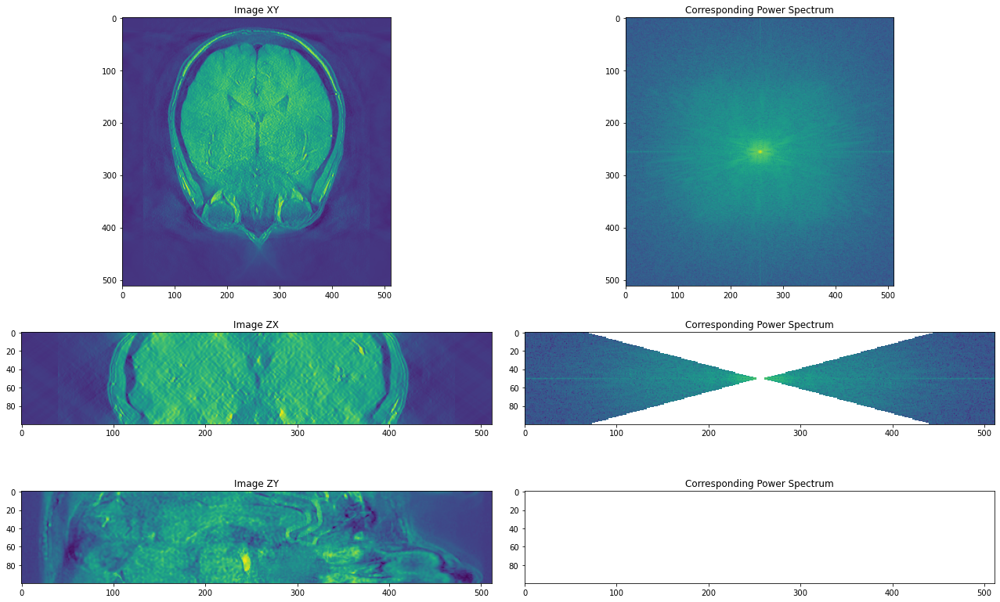

----------------------------------------------------------------------------------------------------------------------------------------------------------------


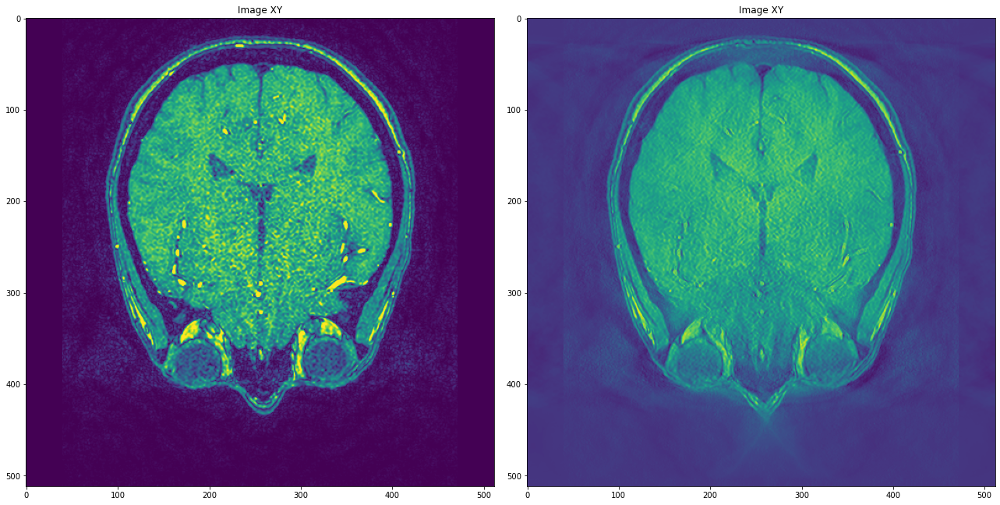

----------------------------------------------------------------------------------------------------------------------------------------------------------------
Tomogram rotated 180 ZY


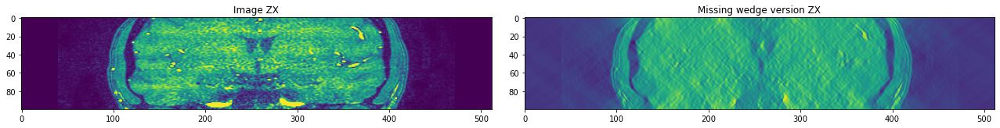

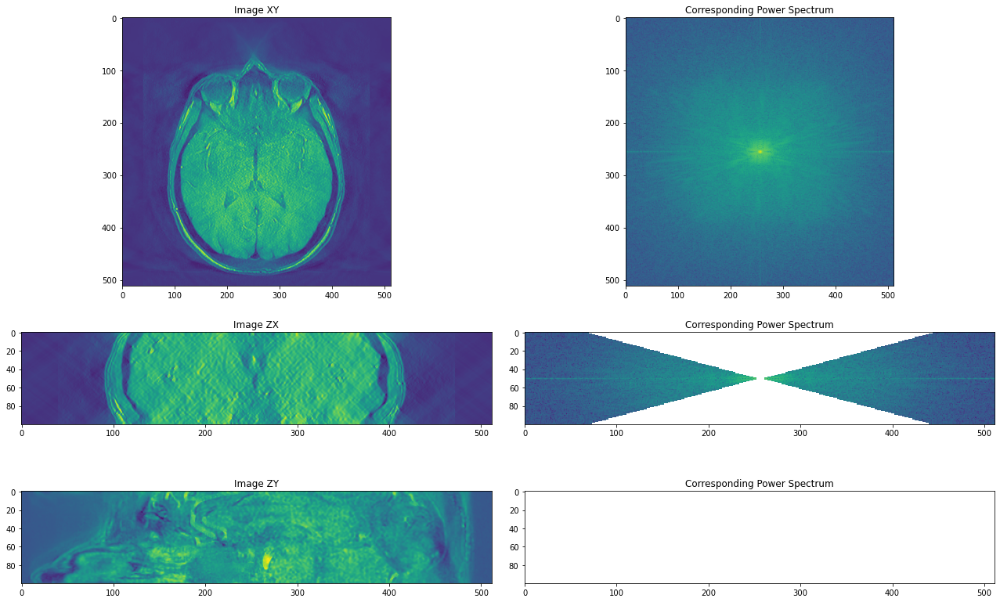

----------------------------------------------------------------------------------------------------------------------------------------------------------------


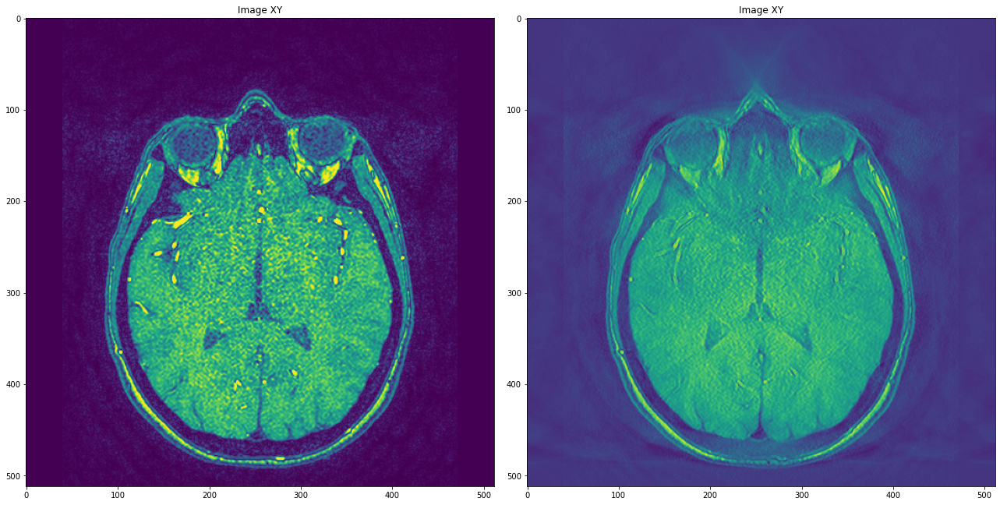

----------------------------------------------------------------------------------------------------------------------------------------------------------------


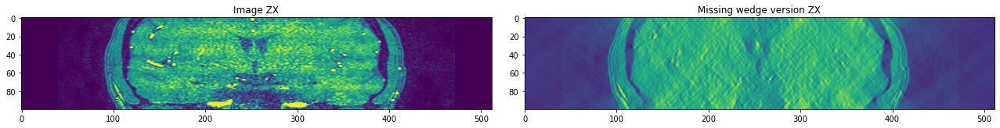

In [61]:
out_path = 'data/isoNet/brain_dummyData_rotated/brain_corrupted/'
out_path = os.path.join(PARENT_PATH, out_path)

file_list = ['IXI002-Guys-0828-MRA.nii.gz']

angular_extent = 15

for i in file_list:
    
    img_path = os.path.join(PARENT_PATH, 'data/ixi_dataset/%s' %i)
    
    img_name = img_path.split('/')[-1].split('.')[0]
    
    _tomo_data = standardize_and_clip(read_array(img_path))
    
    Path(out_path).mkdir(parents=True, exist_ok=True)
    
    # XY rotation
    for k in range(4):
        tomo_data = torch.tensor(_tomo_data)
        tomo_data = torch.rot90(tomo_data, k, dims=[1,2]).numpy()

        tomo_fft = np.fft.fftshift(np.fft.fftn(tomo_data))

        tomo_shape = tomo_fft.shape

        print('Tomogram rotated 90 degrees %d times along XY' %k)

        mw_tomoData, mw_tomoFft = apply_missing_wedge(tomo_fft, angular_extent=angular_extent)
        
        plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft)
        
        mw_img_name = img_name + '_corrupted_ae%02d_XYrot%d.mrc' %(angular_extent, k*90)
        write_array(np.float32(mw_tomoData), os.path.join(out_path, mw_img_name))
        
    # XZ 180 rotation
    tomo_data = torch.tensor(_tomo_data)
    tomo_data = torch.rot90(tomo_data, 2, dims=[0,2]).numpy()

    tomo_fft = np.fft.fftshift(np.fft.fftn(tomo_data))

    tomo_shape = tomo_fft.shape

    print('Tomogram rotated 180 XZ')

    mw_tomoData, mw_tomoFft = apply_missing_wedge(tomo_fft, angular_extent=angular_extent)

    plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft)

    mw_img_name = img_name + '_corrupted_ae%02d_XZrot180.mrc' %angular_extent
    write_array(np.float32(mw_tomoData), os.path.join(out_path, mw_img_name))
    
    # ZY 180 rotation
    tomo_data = torch.tensor(_tomo_data)
    tomo_data = torch.rot90(tomo_data, 2, dims=[0,1]).numpy()

    tomo_fft = np.fft.fftshift(np.fft.fftn(tomo_data))

    tomo_shape = tomo_fft.shape

    print('Tomogram rotated 180 ZY')

    mw_tomoData, mw_tomoFft = apply_missing_wedge(tomo_fft, angular_extent=angular_extent)

    plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft)

    mw_img_name = img_name + '_corrupted_ae%02d_ZYrot180.mrc' %angular_extent
    write_array(np.float32(mw_tomoData), os.path.join(out_path, mw_img_name))